# Welcome to Spark my friends!

Hello ~~World~~ my fellow student!!

Today we will analyze the Song Dataset available on the databricks samples folder

In [ ]:
# Lets set up some configurations first
spark.conf.set("spark.sql.repl.eagerEval.enabled",True)

In [ ]:
%fs ls "/databricks-datasets/songs"

path,name,size,modificationTime
dbfs:/databricks-datasets/songs/README.md,README.md,1719,1454620183000
dbfs:/databricks-datasets/songs/data-001/,data-001/,0,0
dbfs:/databricks-datasets/songs/data-002/,data-002/,0,0


Every Dataset has a readme file with the description of the data, a set of data folders with csv like files on the inside

In [ ]:
%fs head --maxBytes=10000 "/databricks-datasets/songs/README.md"

Sample of Million Song Dataset
===============================

## Source
This data is a small subset of the [Million Song Dataset](http://labrosa.ee.columbia.edu/millionsong/).
The original data was contributed by The Echo Nest.
Prepared by T. Bertin-Mahieux <tb2332 '@' columbia.edu>

## Attribute Information
- artist_id:string
- artist_latitude:double
- artist_longitude:double
- artist_location:string
- artist_name:string
- duration:double
- end_of_fade_in:double
- key:int
- key_confidence:double
- loudness:double
- release:string
- song_hotnes:double
- song_id:string
- start_of_fade_out:double
- tempo:double
- time_signature:double
- time_signature_confidence:double
- title:string
- year:double
- partial_sequence:int

## Citation
Using the dataset?

Please cite the following paper [pdf](http://www.columbia.edu/~tb2332/Papers/ismir11.pdf) [bib](http://labrosa.ee.columbia.edu/millionsong/sites/default/files/millionsong_ismir11_1.bib):

Thierry Bertin-Mahieux, Daniel P.W. Ellis, Brian Whitman, and Paul Lamere. 
The Million Song Dataset. In Proceedings of the 12th International Society
for Music Information Retrieval Conference (ISMIR 2011), 2011.

## Acknowledgements
The Million Song Dataset was created under a grant from the National Science Foundation, project IIS-0713334. The original data was contributed by The Echo Nest, as part of an NSF-sponsored GOALI collaboration. Subsequent donations from SecondHandSongs.com, musiXmatch.com, and last.fm, as well as further donations from The Echo Nest, are gratefully acknowledged.

Any opinions, findings and conclusions or recommendations expressed in this material are those of the authors and do not necessarily reflect the views of the sponsors.

In [ ]:
%fs head --maxBytes=10000 "/databricks-datasets/songs/data-001/part-00000"

[Truncated to first 10000 bytes]
AR81V6H1187FB48872	nan	nan Earl Sixteen	213.7073	0.0	11	0.419	-12.106	Soldier of Jah Army	nan	SOVNZSZ12AB018A9B8	208.289	125.882	1	0.0	Rastaman	2003	--
ARVVZQP11E2835DBCB	nan	nan Wavves	133.25016	0.0	0	0.282	0.596	Wavvves	0.471578247701	SOJTQHQ12A8C143C5F	128.116	89.519	1	0.0	I Want To See You (And Go To The Movies)	2009	--
ARFG9M11187FB3BBCB	nan	nan	Nashua USA	C-Side	247.32689	0.0	9	0.612	-4.896	Santa Festival Compilation 2008 vol.1	nan	SOAJSQL12AB0180501	242.196	171.278	5	1.0	Loose on the Dancefloor	0	225261
ARK4Z2O1187FB45FF0	nan	nan Harvest	337.05751	0.247	4	0.46	-9.092	Underground Community	0.0	SOTDRVW12AB018BEB9	327.436	84.986	4	0.673	No Return	0	101619
AR4VQSG1187FB57E18	35.25082	-91.74015	Searcy, AR	Gossip	430.23628	0.0	2	0.034	-6.846	Yr Mangled Heart	nan	SOTVOCL12A8AE478DD	424.06	121.998	4	0.847	Yr Mangled Heart	2006	740623
ARNBV1X1187B996249	nan	nan Alex	186.80118	0.0	4	0.641	-16.108	Jolgaledin	nan	SODTGRY12AB0182438	166.156	140.735	4	0.055	Mariu Sonur Jesus	0	673970
ARXOEZX1187B9B82A1	nan	nan Elie Attieh	361.89995	0.0	7	0.863	-4.919	ELITE	nan	SOIINTJ12AB0180BA6	354.476	128.024	4	0.399	Fe Yom We Leila	0	280304
ARXPUIA1187B9A32F1	nan	nan	Rome, Italy	Simone Cristicchi	220.00281	2.119	4	0.486	-6.52	Dall'Altra Parte Del Cancello	0.484225272411	SONHXJK12AAF3B5290	214.761	99.954	1	0.928	L'Italiano	2007	745962
ARNPPTH1187B9AD429	51.4855	-0.37196	Heston, Middlesex, England	Jimmy Page	156.86485	0.334	7	0.493	-9.962	No Introduction Necessary [Deluxe Edition]	nan	SOGUHGW12A58A80E06	149.269	162.48	4	0.534	Wailing Sounds	2004	599250
AROGWRA122988FEE45	nan	nan Christos Dantis	256.67873	2.537	9	0.742	-13.404	Daktilika Apotipomata	nan	SOJJOYI12A8C13399D	248.912	134.944	4	0.162	Stin Proigoumeni Zoi	0	611396
ARMLWWX1187B98A4A5	nan	nan Siempre Así	204.64281	0.0	9	0.565	-12.339	Siempre Así	nan	SOIYFVF12A8C13BEED	182.573	99.722	4	0.368	De tu locura	0	780184
ARDR59B1187B993C86	nan	nan Oslo 13	112.48281	0.0	8	0.397	-34.06	Live	nan	SOOWSDD12AC3DF6C84	109.087	88.373	4	0.0	Finale - Intro	0	--
ARHAMGQ1187B9B6491	30.66121	-93.89386	Kirbyville, TX	Ivory Joe Hunter	170.39628	0.166	10	0.434	-9.971	Uprising 50ies	nan	SOIVREI12AC468C0E3	164.833	102.329	5	0.508	I Quit My Pretty Mama	0	373410
ARORFTD1187B99F7D4	nan	nan	台北, Taiwan	Epitaph	215.95383	5.045	7	0.573	-6.728	Return To Reality	0.0	SOEWJZN12AC3DF4A65	204.196	113.745	4	1.0	Set Your Spirit Free	0	837454
AR8UA7Z1187B9AD9C9	48.10751	-1.68447	Rennes	Étienne Daho	303.62077	0.0	1	0.755	-11.422	Live Ed	nan	SORSGDF12A6D4F3B7F	303.621	113.924	3	1.0	Stay with me (Live 1989)	0	138182
ARMLOSJ1187B98B08C	52.08399	4.31741	The Hague, Netherlands	Anouk	266.60526	0.27	4	0.466	-8.759	Urban Solitude	0.592213231387	SOUHUSP12AB01858D3	246.091	131.724	4	0.803	It Wasn't Me	0	882513
ARN1ETG1187FB41238	nan	nan Rivermaya	326.19057	0.09	2	1.0	-8.587	Greatest Hits	0.355521077989	SOXISCD12AB018EF71	314.485	157.781	4	1.0	If	1997	364624
ARQWEFN12086C16CBB	nan	nan Ignominious Incarceration	51.04281	2.368	4	0.0	-5.403	Of Winter Born	0.367273415809	SOXOTMK12AB01889A6	51.043	117.781	4	0.937	The Beginning	2009	54408
ARYCW9Z11C8A42B088	nan	nan Robert Pattinson	129.4624	0.0	8	0.023	-10.231	How To Be [Original Motion Picture Soundtrack]	0.523445682991	SOZIWST12A58A7C80F	129.462	86.782	5	0.394	Doin' Fine	0	756327
AR19DC41187B9A1BED	nan	nan Axel Krygier	253.33506	0.2	2	0.16	-7.634	Secreto y Malibú	0.299877488274	SOMLLWM12A6D4F4DC7	240.292	106.174	4	0.391	Final	2003	514414
ARLGLB31187B9AE0C2	38.2589	-92.43659	Missouri	Deep Thinkers	237.76608	0.0	4	0.308	-5.864	Eastern Conference All-Stars IV	0.212045405484	SOGBCVX12AB018894D	232.728	170.014	4	0.0	War of Words	2004	765175
ARRUHHG11F50C4F353	42.31256	-71.08868	Mass. - Boston	Cheryl Melody	132.96281	0.0	6	0.535	-19.018	World Peace-The Children's Dream	0.0	SOGJQKT12A8C137046	132.963	77.072	3	0.887	Kids Take Action	0	452240
ARVFCVA1187B992D8A	52.51607	13.37698	Berlin, Germany	Fuckpony	399.35955	0.065	1	0.034	-18.853	Children Of Love	nan	SORTWVI12A6D4FB7D4	39

The data files do not have a header and are separated by tab, they do not have the CSV extension, but they can be individually opened.

In [ ]:
df = spark.read.format('csv').option("sep", "\t").load('dbfs:/databricks-datasets/songs/data-001/part-00000')
df.display()

_c0,_c1,_c2,_c3,_c4,_c5,_c6,_c7,_c8,_c9,_c10,_c11,_c12,_c13,_c14,_c15,_c16,_c17,_c18,_c19
AR81V6H1187FB48872,nan,nan,null,Earl Sixteen,213.7073,0.0,11,0.419,-12.106,Soldier of Jah Army,nan,SOVNZSZ12AB018A9B8,208.289,125.882,1,0.0,Rastaman,2003,--
ARVVZQP11E2835DBCB,nan,nan,null,Wavves,133.25016,0.0,0,0.282,0.596,Wavvves,0.471578247701,SOJTQHQ12A8C143C5F,128.116,89.519,1,0.0,I Want To See You (And Go To The Movies),2009,--
ARFG9M11187FB3BBCB,nan,nan,Nashua USA,C-Side,247.32689,0.0,9,0.612,-4.896,Santa Festival Compilation 2008 vol.1,nan,SOAJSQL12AB0180501,242.196,171.278,5,1.0,Loose on the Dancefloor,0,225261
ARK4Z2O1187FB45FF0,nan,nan,null,Harvest,337.05751,0.247,4,0.46,-9.092,Underground Community,0.0,SOTDRVW12AB018BEB9,327.436,84.986,4,0.673,No Return,0,101619
AR4VQSG1187FB57E18,35.25082,-91.74015,"Searcy, AR",Gossip,430.23628,0.0,2,0.034,-6.846,Yr Mangled Heart,nan,SOTVOCL12A8AE478DD,424.06,121.998,4,0.847,Yr Mangled Heart,2006,740623
ARNBV1X1187B996249,nan,nan,null,Alex,186.80118,0.0,4,0.641,-16.108,Jolgaledin,nan,SODTGRY12AB0182438,166.156,140.735,4,0.055,Mariu Sonur Jesus,0,673970
ARXOEZX1187B9B82A1,nan,nan,null,Elie Attieh,361.89995,0.0,7,0.863,-4.919,ELITE,nan,SOIINTJ12AB0180BA6,354.476,128.024,4,0.399,Fe Yom We Leila,0,280304
ARXPUIA1187B9A32F1,nan,nan,"Rome, Italy",Simone Cristicchi,220.00281,2.119,4,0.486,-6.52,Dall'Altra Parte Del Cancello,0.484225272411,SONHXJK12AAF3B5290,214.761,99.954,1,0.928,L'Italiano,2007,745962
ARNPPTH1187B9AD429,51.4855,-0.37196,"Heston, Middlesex, England",Jimmy Page,156.86485,0.334,7,0.493,-9.962,No Introduction Necessary [Deluxe Edition],nan,SOGUHGW12A58A80E06,149.269,162.48,4,0.534,Wailing Sounds,2004,599250
AROGWRA122988FEE45,nan,nan,null,Christos Dantis,256.67873,2.537,9,0.742,-13.404,Daktilika Apotipomata,nan,SOJJOYI12A8C13399D,248.912,134.944,4,0.162,Stin Proigoumeni Zoi,0,611396


Although, instead of iterating over the files and appending the data is best to use the Auto-loader feature to open the dataset with spark

In [ ]:
from pyspark.sql.types import DoubleType, IntegerType, StringType, StructType, StructField

# Define variables used in the code below
file_path = "/databricks-datasets/songs/data-001"
table_name = "songs_raw"
checkpoint_path = "/tmp/pipeline_get_started/_checkpoint/song_data"

schema = StructType(
  [
    StructField("artist_id", StringType(), True),
    StructField("artist_lat", DoubleType(), True),
    StructField("artist_long", DoubleType(), True),
    StructField("artist_location", StringType(), True),
    StructField("artist_name", StringType(), True),
    StructField("duration", DoubleType(), True),
    StructField("end_of_fade_in", DoubleType(), True),
    StructField("key", IntegerType(), True),
    StructField("key_confidence", DoubleType(), True),
    StructField("loudness", DoubleType(), True),
    StructField("release", StringType(), True),
    StructField("song_hotnes", DoubleType(), True),
    StructField("song_id", StringType(), True),
    StructField("start_of_fade_out", DoubleType(), True),
    StructField("tempo", DoubleType(), True),
    StructField("time_signature", DoubleType(), True),
    StructField("time_signature_confidence", DoubleType(), True),
    StructField("title", StringType(), True),
    StructField("year", IntegerType(), True),
    StructField("partial_sequence", IntegerType(), True)
  ]
)



In [ ]:
# Clean up checkpoint folder in case the command needs to run agaun
dbutils.fs.rm(checkpoint_path,True)
# Clean up hive metastore in case the command needs to run again
dbutils.fs.rm(f"/user/hive/warehouse/{table_name}",True)

Out[3]: True

In [ ]:
(spark.readStream
  .format("cloudFiles")
  .schema(schema)
  .option("cloudFiles.allowOverwrites",True)
  .option("cloudFiles.includeExistingFiles", True)
  .option("cloudFiles.format", "csv")
  .option("sep","\t")
  .load(file_path)
  .writeStream
  .option("checkpointLocation", checkpoint_path)
  .trigger(availableNow=True)
  .toTable(table_name)
)


Out[4]: <pyspark.sql.streaming.query.StreamingQuery at 0x7f488493d730>

In [ ]:
%sql
Select * from songs_raw;


artist_id,artist_lat,artist_long,artist_location,artist_name,duration,end_of_fade_in,key,key_confidence,loudness,release,song_hotnes,song_id,start_of_fade_out,tempo,time_signature,time_signature_confidence,title,year,partial_sequence
ARKNTIQ1187FB56EF1,null,null,null,Cliff Bennett & The Rebel Rousers,129.85424,0.351,6,0.009,-4.607,Into Our Lives (The EMI Years 1961-1969),null,SODOBHM12AB018ADE6,123.379,92.023,4.0,1.0,Baby_ Baby_ Baby (Mono) (2009 Digital Remaster),0,null
AR9XPQF1187FB5A693,null,null,null,The Mystic Moods Orchestra,147.33016,3.129,0,0.894,-21.437,Mexican Trip,null,SOIKXBJ12AC3DF8048,147.33,124.508,4.0,0.835,Gay Ranchero,1967,null
ARMARKK11E2835C4DD,null,null,null,Jeff Dunham ft. Peanut,171.54567,0.0,0,0.497,-10.15,Don't Come Home For Christmas,0.517376318437,SOFKOZK12A8C142F29,168.461,120.049,4.0,0.68,Song For Jeff,2008,225261
AR0U44O1187B99007C,51.50632,-0.12714,"London, England",Republica,264.22812,0.136,5,0.572,-3.653,Speed Ballads,0.531722098421,SOFZXEV12A8C13A407,260.377,137.953,4.0,0.43,Pub Pusher,1998,101619
ARPWMHJ1187B9B08CA,null,null,null,Cultural Amnesia,160.62649,0.102,6,0.467,-8.604,Electricity 3 - An Electropop Sampler,0.287629542999,SOEEQTI12AB017F8FD,151.47,100.174,4.0,1.0,I Am Taking Photographs (album cut),0,740623
ARSYSM31187B9A5A80,null,null,null,J.D. NATASHA,160.7571,0.0,10,0.735,-3.752,Imperfecta/ Imperfect (Clean Version),0.52504914858,SOQCCUO12A6D4F7B48,160.757,166.282,4.0,0.329,Plastico (Edited Version),0,673970
AR8CRLE1187FB4E949,null,null,null,G. Love,179.80036,0.351,8,0.006,-12.032,The Hustle,0.376169924841,SOSVKIW12A8C137E79,169.099,156.909,4.0,0.0,Ma Mere,2004,280304
ARVML4B1187FB52324,40.73197,-74.17418,"Newark, NJ",Leroy Hutson,239.0722,0.148,9,0.407,-14.616,Love Oh Love,0.52549711888,SOVPJYZ12A58A7CA20,229.918,142.434,4.0,0.0,Getting It On,1973,745962
AR1YOLL1187FB40011,null,null,null,Carlos Y José,182.80444,0.557,6,0.137,-7.566,Coleccion Superma Plus- Carlos Y Jose,null,SOMPKDD12A8AE48A9E,177.447,115.258,4.0,1.0,Modesto Ayala,0,599250
ARYVIIA1187B9A2BD4,41.50075,-99.68095,Nebraska,Cold Sweat,412.00281,6.13,2,0.472,-13.81,The Adventures of Tigerman and Slick,null,SOVUUDA12AB0182574,392.876,129.926,4.0,0.795,Ashes,0,611396


In [ ]:
# Clear target table folder in hive metastore
dbutils.fs.rm("/user/hive/warehouse/songs",True)

Out[6]: True

In [ ]:
%sql
CREATE OR REPLACE TABLE
  songs (
    artist_id STRING,
    artist_name STRING,
    duration DOUBLE,
    release STRING,
    tempo DOUBLE,
    time_signature DOUBLE,
    title STRING,
    year DOUBLE,
    processed_time TIMESTAMP
  );

INSERT INTO
  songs
SELECT
  artist_id,
  artist_name,
  duration,
  release,
  tempo,
  time_signature,
  title,
  year,
  current_timestamp()
FROM
  songs_raw

num_affected_rows,num_inserted_rows
31389,31389


In [ ]:
%sql
select * from songs

artist_id,artist_name,duration,release,tempo,time_signature,title,year,processed_time
ARKNTIQ1187FB56EF1,Cliff Bennett & The Rebel Rousers,129.85424,Into Our Lives (The EMI Years 1961-1969),92.023,4.0,Baby_ Baby_ Baby (Mono) (2009 Digital Remaster),0.0,2023-09-26T01:58:50.812+0000
AR9XPQF1187FB5A693,The Mystic Moods Orchestra,147.33016,Mexican Trip,124.508,4.0,Gay Ranchero,1967.0,2023-09-26T01:58:50.812+0000
ARMARKK11E2835C4DD,Jeff Dunham ft. Peanut,171.54567,Don't Come Home For Christmas,120.049,4.0,Song For Jeff,2008.0,2023-09-26T01:58:50.812+0000
AR0U44O1187B99007C,Republica,264.22812,Speed Ballads,137.953,4.0,Pub Pusher,1998.0,2023-09-26T01:58:50.812+0000
ARPWMHJ1187B9B08CA,Cultural Amnesia,160.62649,Electricity 3 - An Electropop Sampler,100.174,4.0,I Am Taking Photographs (album cut),0.0,2023-09-26T01:58:50.812+0000
ARSYSM31187B9A5A80,J.D. NATASHA,160.7571,Imperfecta/ Imperfect (Clean Version),166.282,4.0,Plastico (Edited Version),0.0,2023-09-26T01:58:50.812+0000
AR8CRLE1187FB4E949,G. Love,179.80036,The Hustle,156.909,4.0,Ma Mere,2004.0,2023-09-26T01:58:50.812+0000
ARVML4B1187FB52324,Leroy Hutson,239.0722,Love Oh Love,142.434,4.0,Getting It On,1973.0,2023-09-26T01:58:50.812+0000
AR1YOLL1187FB40011,Carlos Y José,182.80444,Coleccion Superma Plus- Carlos Y Jose,115.258,4.0,Modesto Ayala,0.0,2023-09-26T01:58:50.812+0000
ARYVIIA1187B9A2BD4,Cold Sweat,412.00281,The Adventures of Tigerman and Slick,129.926,4.0,Ashes,0.0,2023-09-26T01:58:50.812+0000


In [ ]:
songs_df = spark.read.table("songs")
display(songs_df)

artist_id,artist_name,duration,release,tempo,time_signature,title,year,processed_time
ARKNTIQ1187FB56EF1,Cliff Bennett & The Rebel Rousers,129.85424,Into Our Lives (The EMI Years 1961-1969),92.023,4.0,Baby_ Baby_ Baby (Mono) (2009 Digital Remaster),0.0,2023-09-26T01:58:50.812+0000
AR9XPQF1187FB5A693,The Mystic Moods Orchestra,147.33016,Mexican Trip,124.508,4.0,Gay Ranchero,1967.0,2023-09-26T01:58:50.812+0000
ARMARKK11E2835C4DD,Jeff Dunham ft. Peanut,171.54567,Don't Come Home For Christmas,120.049,4.0,Song For Jeff,2008.0,2023-09-26T01:58:50.812+0000
AR0U44O1187B99007C,Republica,264.22812,Speed Ballads,137.953,4.0,Pub Pusher,1998.0,2023-09-26T01:58:50.812+0000
ARPWMHJ1187B9B08CA,Cultural Amnesia,160.62649,Electricity 3 - An Electropop Sampler,100.174,4.0,I Am Taking Photographs (album cut),0.0,2023-09-26T01:58:50.812+0000
ARSYSM31187B9A5A80,J.D. NATASHA,160.7571,Imperfecta/ Imperfect (Clean Version),166.282,4.0,Plastico (Edited Version),0.0,2023-09-26T01:58:50.812+0000
AR8CRLE1187FB4E949,G. Love,179.80036,The Hustle,156.909,4.0,Ma Mere,2004.0,2023-09-26T01:58:50.812+0000
ARVML4B1187FB52324,Leroy Hutson,239.0722,Love Oh Love,142.434,4.0,Getting It On,1973.0,2023-09-26T01:58:50.812+0000
AR1YOLL1187FB40011,Carlos Y José,182.80444,Coleccion Superma Plus- Carlos Y Jose,115.258,4.0,Modesto Ayala,0.0,2023-09-26T01:58:50.812+0000
ARYVIIA1187B9A2BD4,Cold Sweat,412.00281,The Adventures of Tigerman and Slick,129.926,4.0,Ashes,0.0,2023-09-26T01:58:50.812+0000


#### Lets run some Exploratory Data Analysis (EDA)

In [ ]:
# Check the schema of the DataFrame
songs_df.printSchema()

root
 |-- artist_id: string (nullable = true)
 |-- artist_name: string (nullable = true)
 |-- duration: double (nullable = true)
 |-- release: string (nullable = true)
 |-- tempo: double (nullable = true)
 |-- time_signature: double (nullable = true)
 |-- title: string (nullable = true)
 |-- year: double (nullable = true)
 |-- processed_time: timestamp (nullable = true)



In [ ]:
# Basic summary statistics
songs_df.describe().show()

+-------+------------------+------------------+------------------+---------+------------------+------------------+--------------------+-----------------+
|summary|         artist_id|       artist_name|          duration|  release|             tempo|    time_signature|               title|             year|
+-------+------------------+------------------+------------------+---------+------------------+------------------+--------------------+-----------------+
|  count|             31389|             31369|             31369|    31369|             31369|             31369|               31368|            31369|
|   mean|              null|1272.3481481481483|249.47154346807355| Infinity|124.14285128630173|3.5953648506487297|            Infinity|1032.822563677516|
| stddev|              null| 2293.014085362215|123.31752590753882|      NaN| 35.13414702812376| 1.225434020116505|                 NaN|998.6985447225715|
|    min|AR003FB1187B994355|      & And Oceans|           0.62649|Em Are I|

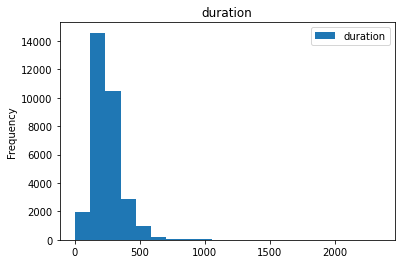

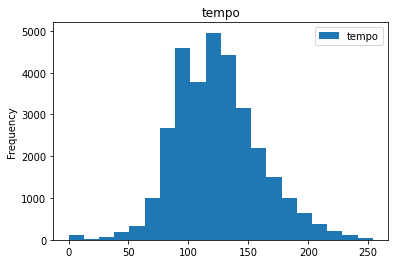

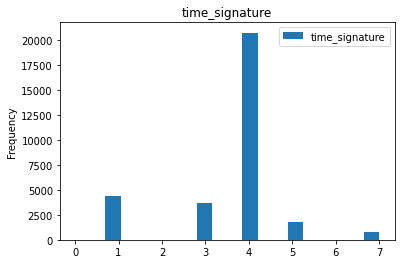

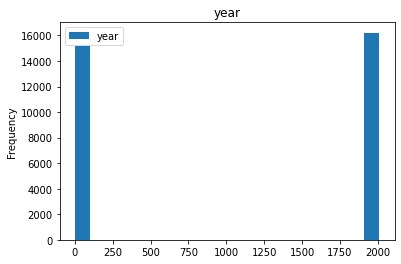

In [ ]:
import pyspark.sql.functions as F
import matplotlib.pyplot as plt
# Plot histograms for numerical columns
numeric_columns = [col_name for col_name, data_type in songs_df.dtypes if data_type in ['int', 'double']]
for col in numeric_columns:
    songs_df.select(col).toPandas().plot(kind='hist', bins=20, title=col)
    plt.show()

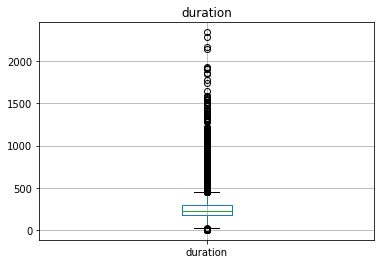

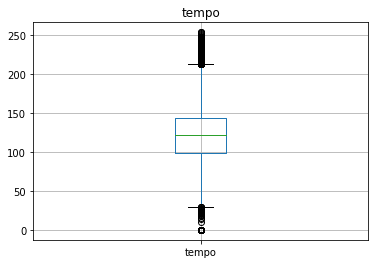

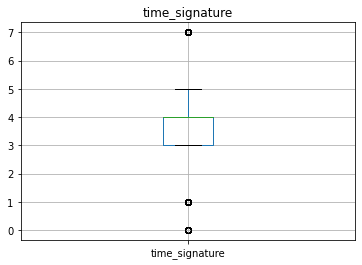

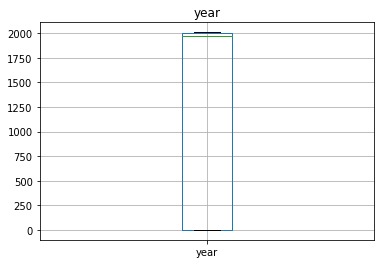

In [ ]:
# Box plots for numerical columns
for col in numeric_columns:
    songs_df.select(col).toPandas().boxplot()
    plt.title(col)
    plt.show()

#### Lets see if there is any correlation within the numeric columns of the songs dataframe

In [ ]:
import pandas as pd
# Correlation matrix for numerical columns
correlation_matrix = pd.DataFrame(columns=numeric_columns, index=numeric_columns).astype(float)
for col1 in numeric_columns:
    for col2 in numeric_columns:
        correlation = songs_df.corr(col1, col2)
        correlation_matrix.at[col1, col2] = correlation


Correlation Matrix:
                duration     tempo  time_signature      year
duration        1.000000 -0.012679        0.111295 -0.028763
tempo          -0.012679  1.000000        0.052264  0.026181
time_signature  0.111295  0.052264        1.000000  0.015998
year           -0.028763  0.026181        0.015998  1.000000


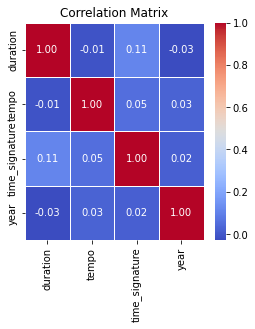

In [ ]:
import seaborn as sns
print("Correlation Matrix:")
print(correlation_matrix)
plt.figure(figsize=correlation_matrix.shape)
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=.5)
plt.title('Correlation Matrix')
plt.show()



#### Now we will augment the data using  a simple function to retrieve information about a song author

In [ ]:
# Lets look how many authors do we have
print(f"There are {songs_df.select('artist_name').distinct().count()} artist for the {songs_df.count()} songs listed on the DF")

There are 19056 artist for the 31389 songs listed on the DF


In [ ]:
from pyspark.sql.types import StringType
import requests

# First lets create a User Defined Function (UDF)
def retrieve_author_info(author_name):
    API_URL = 'https://trypap.com/'
    try:
        # Make an API call
        # response = requests.get(api_url, params={'artist': author_name})

        # Lets fake it just for fun
        response = {'status_code':200, 'result': f"Who's your daddy?, Thats right is {author_name}"}
        if response['status_code'] == 200:
            data = response['result']
        else:
            data = 'How dare you to break my precious API Call?'
        return data
    except Exception as e:
        print("Whoopsy daisy")
        return 'I am ashamed of you'
# Register our function as a UDF within the Spark context, 
# this will make the function available for all executors on the spark cluster
    
author_info_UDF = F.udf(lambda x:retrieve_author_info(x),StringType()) 

In [ ]:
artist_info_df = songs_df.select('artist_name').distinct().withColumn("artist_info", author_info_UDF(F.col("artist_name")))
display(artist_info_df)

artist_name,artist_info
Beyond The Embrace,"Who's your daddy?, Thats right is Beyond The Embrace"
The Partridge Family,"Who's your daddy?, Thats right is The Partridge Family"
Henry Mancini;Mason Jones;John De Lancie;Louis Rosenblatt;Gerald Carlyss,"Who's your daddy?, Thats right is Henry Mancini;Mason Jones;John De Lancie;Louis Rosenblatt;Gerald Carlyss"
Los Lobos,"Who's your daddy?, Thats right is Los Lobos"
Katja Ebstein,"Who's your daddy?, Thats right is Katja Ebstein"
Eurythmics,"Who's your daddy?, Thats right is Eurythmics"
The Black Keys,"Who's your daddy?, Thats right is The Black Keys"
Shannon McNally,"Who's your daddy?, Thats right is Shannon McNally"
Chromatics,"Who's your daddy?, Thats right is Chromatics"
Semisonic / Carole King,"Who's your daddy?, Thats right is Semisonic / Carole King"


#### Now we have a look up dataframe and our main one, the only thing left is to join them by their common key, 'artist_name'

In [ ]:
augmented_df = songs_df.alias("main").join(artist_info_df.alias("lookup"), \
    F.col("main.artist_name") == F.col("lookup.artist_name"), "inner") \
    .select(F.col("main.*"),F.col("lookup.artist_info"))
display(augmented_df)

artist_id,artist_name,duration,release,tempo,time_signature,title,year,processed_time,artist_info
ARKNTIQ1187FB56EF1,Cliff Bennett & The Rebel Rousers,129.85424,Into Our Lives (The EMI Years 1961-1969),92.023,4.0,Baby_ Baby_ Baby (Mono) (2009 Digital Remaster),0.0,2023-09-26T01:58:50.812+0000,"Who's your daddy?, Thats right is Cliff Bennett & The Rebel Rousers"
AR9XPQF1187FB5A693,The Mystic Moods Orchestra,147.33016,Mexican Trip,124.508,4.0,Gay Ranchero,1967.0,2023-09-26T01:58:50.812+0000,"Who's your daddy?, Thats right is The Mystic Moods Orchestra"
ARMARKK11E2835C4DD,Jeff Dunham ft. Peanut,171.54567,Don't Come Home For Christmas,120.049,4.0,Song For Jeff,2008.0,2023-09-26T01:58:50.812+0000,"Who's your daddy?, Thats right is Jeff Dunham ft. Peanut"
AR0U44O1187B99007C,Republica,264.22812,Speed Ballads,137.953,4.0,Pub Pusher,1998.0,2023-09-26T01:58:50.812+0000,"Who's your daddy?, Thats right is Republica"
ARPWMHJ1187B9B08CA,Cultural Amnesia,160.62649,Electricity 3 - An Electropop Sampler,100.174,4.0,I Am Taking Photographs (album cut),0.0,2023-09-26T01:58:50.812+0000,"Who's your daddy?, Thats right is Cultural Amnesia"
ARSYSM31187B9A5A80,J.D. NATASHA,160.7571,Imperfecta/ Imperfect (Clean Version),166.282,4.0,Plastico (Edited Version),0.0,2023-09-26T01:58:50.812+0000,"Who's your daddy?, Thats right is J.D. NATASHA"
AR8CRLE1187FB4E949,G. Love,179.80036,The Hustle,156.909,4.0,Ma Mere,2004.0,2023-09-26T01:58:50.812+0000,"Who's your daddy?, Thats right is G. Love"
ARVML4B1187FB52324,Leroy Hutson,239.0722,Love Oh Love,142.434,4.0,Getting It On,1973.0,2023-09-26T01:58:50.812+0000,"Who's your daddy?, Thats right is Leroy Hutson"
AR1YOLL1187FB40011,Carlos Y José,182.80444,Coleccion Superma Plus- Carlos Y Jose,115.258,4.0,Modesto Ayala,0.0,2023-09-26T01:58:50.812+0000,"Who's your daddy?, Thats right is Carlos Y José"
ARYVIIA1187B9A2BD4,Cold Sweat,412.00281,The Adventures of Tigerman and Slick,129.926,4.0,Ashes,0.0,2023-09-26T01:58:50.812+0000,"Who's your daddy?, Thats right is Cold Sweat"


#### Lets store this thing on our data lakehouse

In [ ]:
options_map = {
    "sfURL" :"<organization>-<account-id>.snowflakecomputing.com",
    "sfUser" : "<snowflake-user>",
    "sfPassword" : "",
    "sfDatabase" : "<database>",
    "sfSchema" : "PUBLIC",
    "sfRole" : "ACCOUNTADMIN",
    "sfWarehouse":"COMPUTE_WH",
    "dbtable" : "songs"
    }

augmented_df.write \
    .format("snowflake") \
    .options(**options_map) \
    .mode("overwrite") \
    .save()